In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
sales=pd.read_csv(r'C:\Users\User\OneDrive - ООО «Эдвансд»\pptx for unilever\data for charts\cut_with_dr_sales_events_top_3000.csv')

C:\Users\User\anaconda3\lib\site-packages\IPython\core\interactiveshell.py:3165: DtypeWarning: Columns (2) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,


In [3]:
dr=pd.read_csv(r'C:\Users\User\OneDrive - ООО «Эдвансд»\pptx for unilever\data for charts\dr_top_3000.csv')

In [4]:
forecast=pd.read_csv(r'C:\Users\User\OneDrive - ООО «Эдвансд»\pptx for unilever\data for charts\total_forecast_top_3000.csv')

<AxesSubplot:xlabel='G_WEEK'>

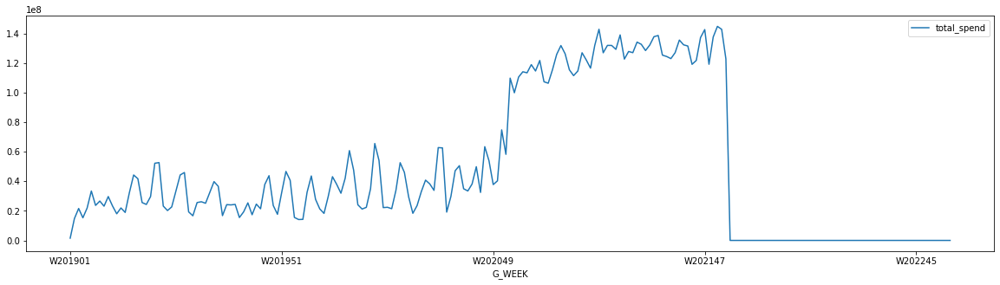

In [5]:
sales.groupby('G_WEEK').sum()[['total_spend']].plot(figsize=(20,5))

In [6]:
sales = sales.sort_values(by='G_WEEK')
sales = sales[sales['G_WEEK'] >= 'W202101']

In [35]:
sales_hist = sales[sales['Train/Test/FC']!='fc']
sales_hist

,cpf,G_WEEK,UPC,CUSTOMER,MASTER_FAMILY_CD,PROMO_FAMILY_CD,PHY_CS,ACTUAL_NSV,PLANNED_ACCOUNT_DESC,FIRST_PROMO_FAMILY_CD,...,master_event_OOH_ZSPS_S,master_event_Promo_w_N,master_event_ROT,master_event_Special_Pa,master_event_TBE,master_event_TBR,master_event_Unmappable,master_event_ZPRM,master_event_ZRBS,master_event_N
2,000052_002240063913,W202116,002240063913,52,0JV,0OI,1853.0,15803.65,PLANNED_ACCOUNT_DESC,0OI,...,0,0,0,0,0,0,0,0,0,1
3,000052_002240063913,W202004,002240063913,52,0JV,0OI,2650.0,22601.05,PLANNED_ACCOUNT_DESC,0OI,...,0,0,0,0,0,0,0,0,0,0
4,000052_002240063913,W202035,002240063913,52,0JV,0OI,2014.0,17176.76,PLANNED_ACCOUNT_DESC,0OI,...,0,0,0,0,0,0,0,0,0,0
6,000052_002240063913,W201950,002240063913,52,0JV,0OI,3657.0,30972.72,PLANNED_ACCOUNT_DESC,0OI,...,0,0,0,0,0,0,0,0,0,0
7,000052_002240063913,W202012,002240063913,52,0JV,0OI,4081.0,34805.60,PLANNED_ACCOUNT_DESC,0OI,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495655,000691_002240039365,W201923,002240039365,691,0K2,0OQ,896.0,18325.07,PLANNED_ACCOUNT_DESC,0OQ,...,0,0,0,0,0,0,0,0,0,0
495656,000691_002240039365,W202002,002240039365,691,0K2,0OQ,672.0,13686.98,PLANNED_ACCOUNT_DESC,0OQ,...,0,0,0,0,0,0,0,0,0,0
495658,000691_002240039365,W201921,002240039365,691,0K2,0OQ,784.0,16013.45,PLANNED_ACCOUNT_DESC,0OQ,...,0,0,0,0,0,0,0,0,0,0
495659,000691_002240039365,W201924,002240039365,691,0K2,0OQ,560.0,11453.19,PLANNED_ACCOUNT_DESC,0OQ,...,0,0,0,0,0,0,0,0,0,0


In [7]:
forecast['G_WEEK']='W'+forecast['PROMO_PLN_YR_CD'].astype(str)+forecast['WEEK_NR'].astype(str).str.zfill(2)
forecast.rename(columns={'SUPPLEMENTAL_VOLUME_NR': 'forecast'}, inplace=True)


In [33]:
r_df = sales[['cpf','G_WEEK','PHY_CS','total_spend']].merge(forecast[['cpf','G_WEEK','forecast']], on =['cpf','G_WEEK'], how = 'outer')

r_df = r_df.sort_values(by='G_WEEK')

r_df = r_df[r_df['G_WEEK'] >= 'W202101']

r_df = r_df[(r_df['G_WEEK'] >= 'W202101')&(r_df['G_WEEK'] < 'W202201')]

r_df

In [12]:
r_df[r_df['G_WEEK'] >= 'W202201']['total_spend'].unique()

array([0.])

In [32]:
r_df['PLAN_INVEST'].fillna(0, inplace=True)

C:\Users\User\anaconda3\lib\site-packages\pandas\core\series.py:4463: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


In [36]:
r_df['PLAN_INVEST'].astype(int)

104717    48414
165174     8053
7467      30451
260136    95628
167050    33054
          ...  
381006        0
440386        0
343523        0
485814        0
492026        0
Name: PLAN_INVEST, Length: 308819, dtype: int32

In [29]:
top_cpfs = r_df[r_df['cpf'].str.startswith('000488')]['cpf'].head(300).tolist()

In [21]:
top_cpfs = r_df.sort_values(by = 'total_spend', ascending=False)['cpf'].head(300).tolist()

In [ ]:
r_df[r_df[]].sort_values(by = 'total_spend', ascending=False)['cpf'].head(300).tolist()

In [30]:
top_cpfs

['000488_007585607870',
 '000488_007756738393',
 '000488_018685200006',
 '000488_079452200142',
 '000488_004589310749',
 '000488_007756708516',
 '000488_007684040021',
 '000488_004800121357',
 '000488_007684010035',
 '000488_007756728320',
 '000488_007756725421',
 '000488_079452220045',
 '000488_007756725420',
 '000488_007756725434',
 '000488_007756725442',
 '000488_007684007657',
 '000488_007756728192',
 '000488_004100058797',
 '000488_007756722482',
 '000488_018685200007',
 '000488_004100057623',
 '000488_007756726479',
 '000488_007684010207',
 '000488_001111168541',
 '000488_007756722700',
 '000488_007684010058',
 '000488_073291345082',
 '000488_007756725450',
 '000488_007756728190',
 '000488_007684010015',
 '000488_007684010132',
 '000488_007756700083',
 '000488_007756725444',
 '000488_04100002268L',
 '000488_004100058794',
 '000488_007756725423',
 '000488_079452220023',
 '000488_018685200011',
 '000488_004800135450',
 '000488_007756725440',
 '000488_007756725004',
 '000488_0186852

C:\Users\User\anaconda3\lib\site-packages\pandas\plotting\_matplotlib\core.py:337: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


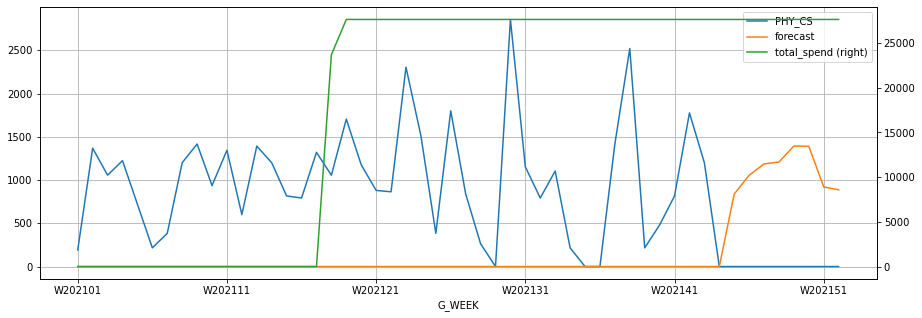

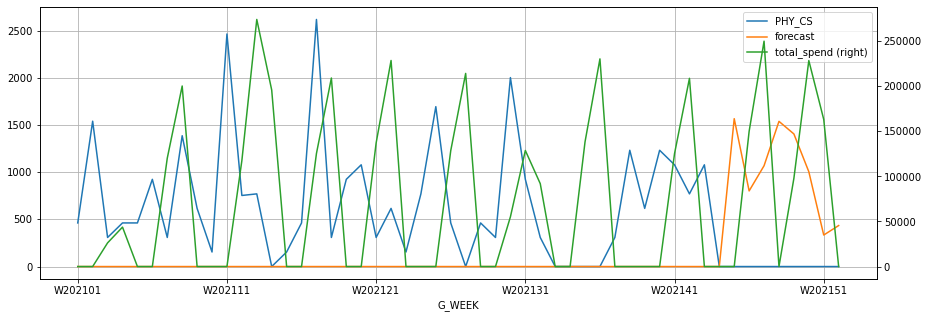

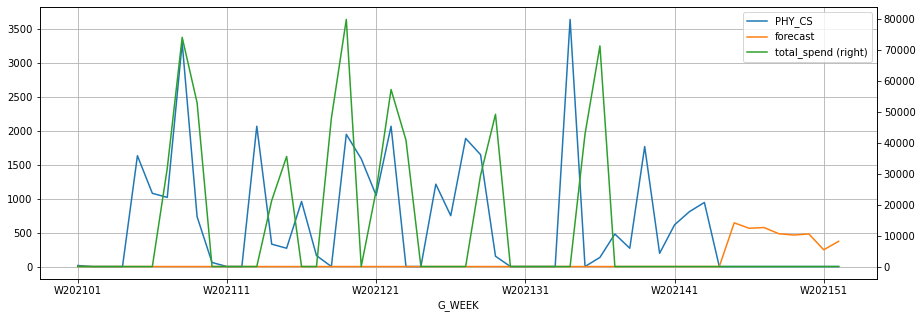

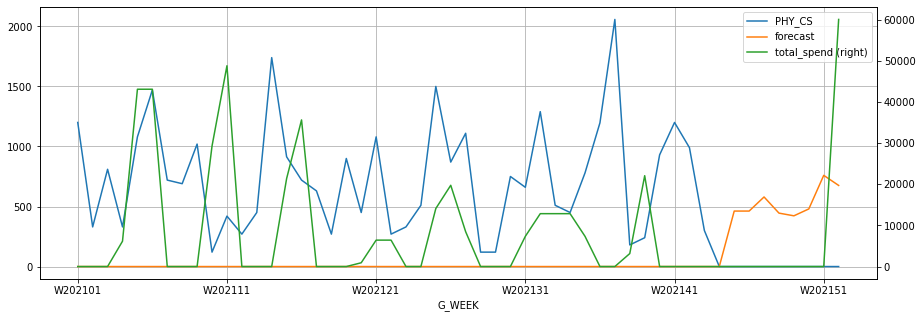

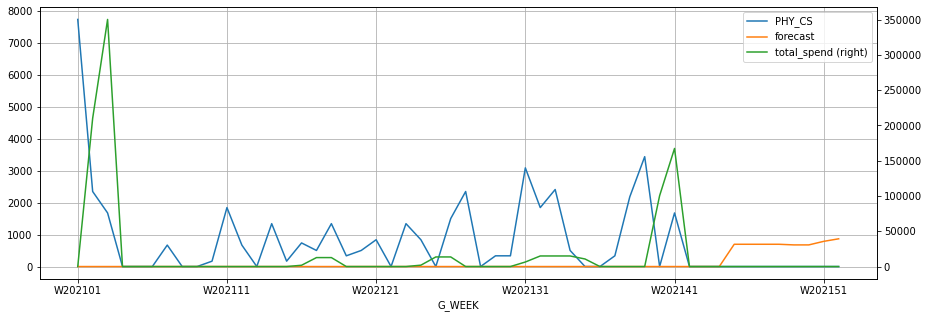

...

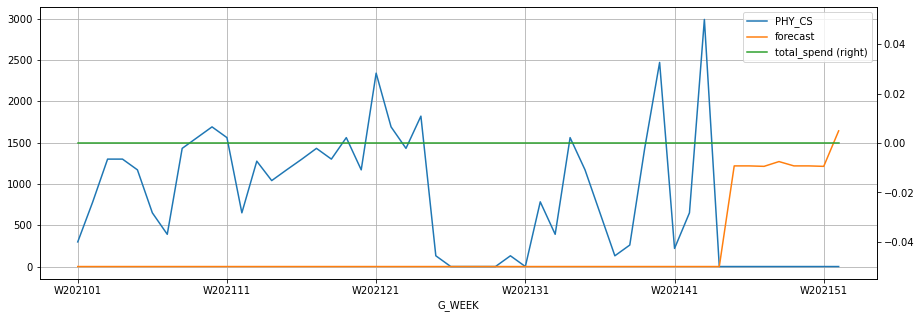

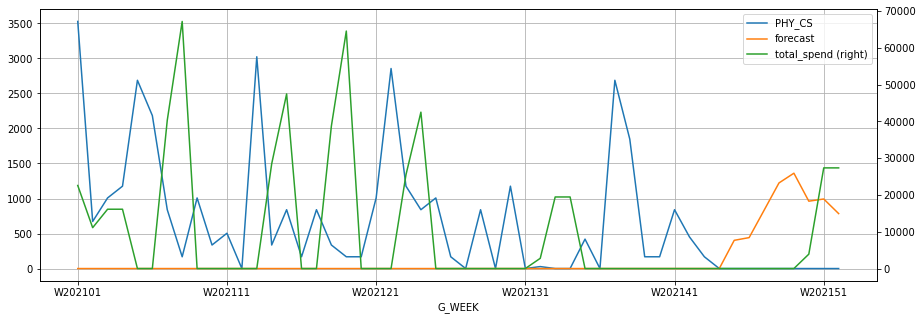

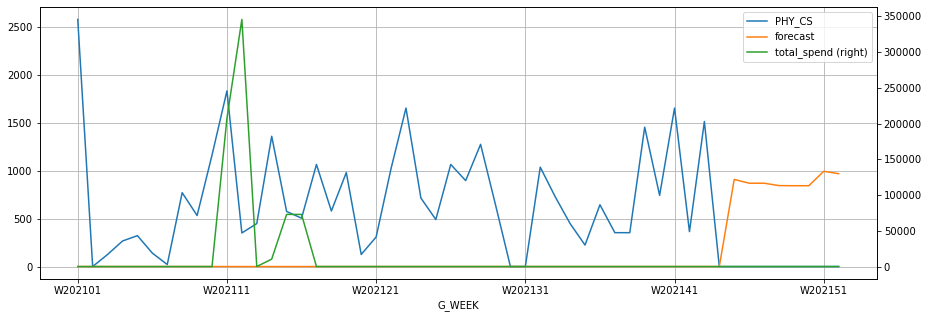

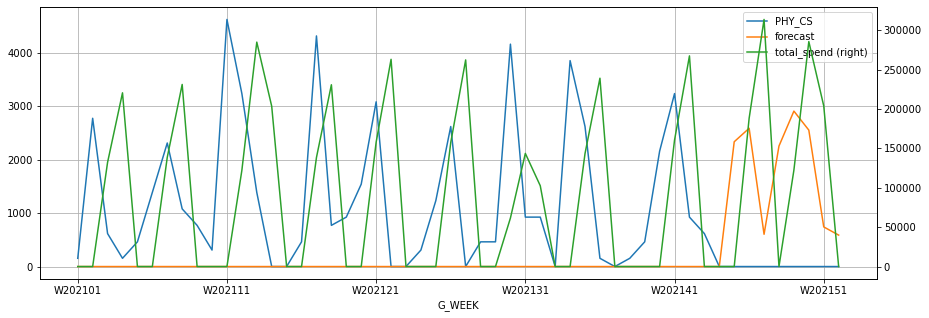

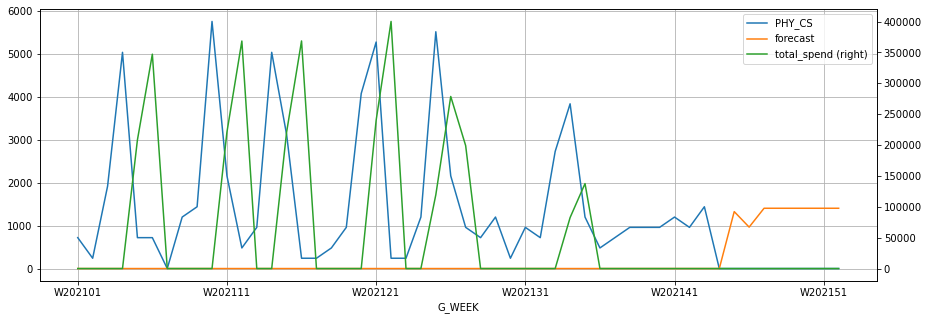

In [32]:
for cpf in top_cpfs:
    sample = r_df[r_df['cpf']==cpf]
    ax = sample.groupby('G_WEEK', as_index=False).agg({'PHY_CS': sum, 'total_spend': sum, 'forecast': sum}).plot(x='G_WEEK', y=['PHY_CS','forecast'], figsize=[15, 5], grid=True)
    r_df[r_df['cpf']==cpf].plot(x='G_WEEK', y=['total_spend'], ax=ax, secondary_y=True, figsize=[15, 5], grid=True)  